# Task

* Amazing Cruise Line is a ship operator with two identical cruise ships.
* The task is to research what can be decided about the given routes and the technical data of the ships.
* The ships are "siblings", i.e. they have identical models.
* You can find more information about the variables in the table below.


| Variable | Description | Unit |
|---|---|---|
| STW | Speed Through Water | Knots |
| power@propulsion  | Power consumption for propulsion | MW |
| trim | Difference in draft between the forward and aft part of the vessel | Meters |
| trim.optimum | trim where energy consumption is at minimum | Meters |

# Data

In [1]:
import pandas
import folium
from folium.plugins import MarkerCluster
import matplotlib
import seaborn as sns

In [2]:
df = pandas.read_excel('data.xlsm')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3530 entries, 0 to 3529
Data columns (total 10 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   time                 3530 non-null   datetime64[ns]
 1   vessel               3530 non-null   object        
 2   departure_port_name  2623 non-null   object        
 3   arrival_port_name    2623 non-null   object        
 4   latitude             3523 non-null   float64       
 5   longitude            3523 non-null   float64       
 6   stw                  3523 non-null   float64       
 7   trim                 3519 non-null   float64       
 8   trim.optimum         2428 non-null   float64       
 9   power@propulsion     3523 non-null   float64       
dtypes: datetime64[ns](1), float64(6), object(3)
memory usage: 275.9+ KB


In [4]:
df.isnull().sum()

time                      0
vessel                    0
departure_port_name     907
arrival_port_name       907
latitude                  7
longitude                 7
stw                       7
trim                     11
trim.optimum           1102
power@propulsion          7
dtype: int64

In [5]:
df.head()

,time,vessel,departure_port_name,arrival_port_name,latitude,longitude,stw,trim,trim.optimum,power@propulsion
0,2016-11-22 21:45:00,Amazing Sea,Fort Lauderdale,Cozumel,26.09383,-80.09159,10.821,-0.300,NaN,3.134770
1,2016-11-22 21:50:00,Amazing Sea,Fort Lauderdale,Cozumel,26.09533,-80.07893,8.894,-0.248,NaN,2.708782
2,2016-11-22 21:55:00,Amazing Sea,Fort Lauderdale,Cozumel,26.09647,-80.06330,12.618,-0.165,-0.087,10.263524
3,2016-11-22 22:00:00,Amazing Sea,Fort Lauderdale,Cozumel,26.09052,-80.04294,16.570,-0.204,-0.193,13.289762
4,2016-11-22 22:05:00,Amazing Sea,Fort Lauderdale,Cozumel,26.07480,-80.02647,17.813,-0.270,-0.326,12.502000


In [6]:
df.describe()

,latitude,longitude,stw,trim,trim.optimum,power@propulsion
count,3523.000000,3523.000000,3523.000000,3519.000000,2428.000000,3523.000000
mean,20.712155,-82.335586,14.408238,-0.236485,-0.370433,14.194387
std,2.558286,4.299313,8.886625,0.202593,0.070042,10.556417
min,16.222460,-88.181370,-5.296000,-0.674000,-0.479000,0.000000
25%,18.957315,-86.499000,0.494500,-0.392000,-0.400000,1.046431
50%,20.476000,-82.620670,18.092000,-0.300000,-0.385000,13.398294
75%,22.855110,-79.714490,21.863000,-0.054000,-0.341000,26.008500
max,26.096470,-72.250230,23.808000,0.453000,-0.077000,30.194000


In [7]:
# calcuclate difference between optimum trim and trim
df["trim.diff"] = abs(df["trim.optimum"] - df.trim)

[Text(0.5, 1.0, 'Speed Through Water (Knots) by vessels')]

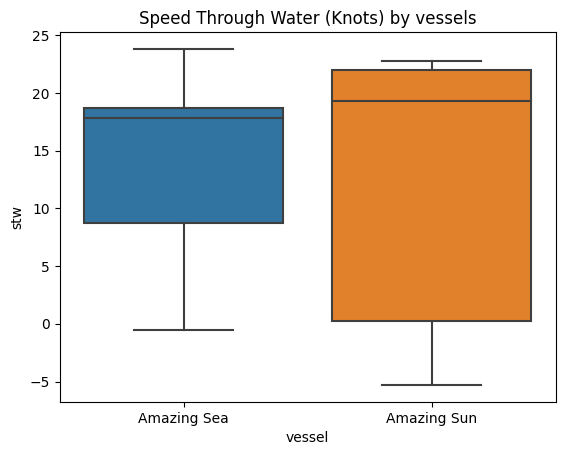

In [41]:
sns.boxplot(data=df, x="vessel", y="stw").set(title='Speed Through Water (Knots) by vessels')

[Text(0.5, 1.0, 'Power Propulsion (MW) by vessels')]

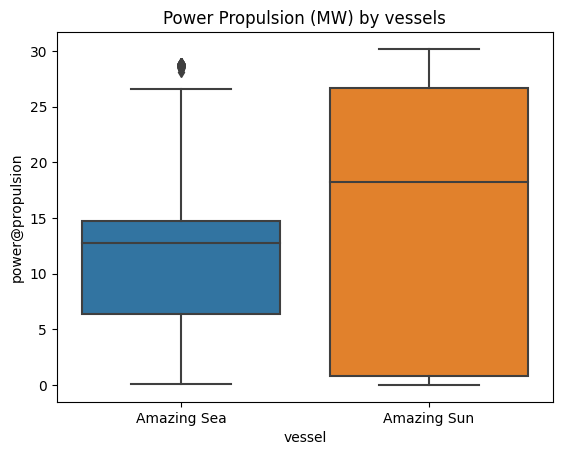

In [42]:
sns.boxplot(data=df, x="vessel", y="power@propulsion").set(title='Power Propulsion (MW) by vessels')

In [10]:
df[["vessel", "stw", "power@propulsion"]].groupby("vessel").mean()

,stw,power@propulsion
vessel,,
Amazing Sea,14.377762,12.596178
Amazing Sun,14.437811,15.745222


In [11]:
(abs(df.where(df.vessel=="Amazing Sea")["power@propulsion"].mean() - df.where(df.vessel=="Amazing Sun")["power@propulsion"].mean())/df.where(df.vessel=="Amazing Sea")["power@propulsion"].mean())*100


24.99999999976162

## Amazing Sun has 25% larger power consumption in average than Amazing Sea, but the average speed trough water (STW) is almost the same.

[Text(0.5, 1.0, 'Trim by vessels')]

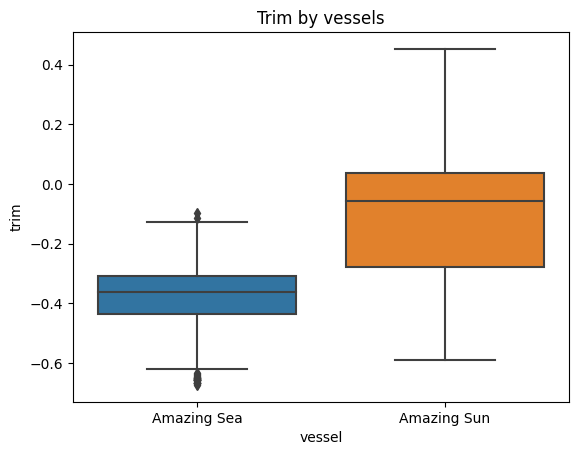

In [43]:
sns.boxplot(data=df, x="vessel", y="trim").set(title='Trim by vessels')

[Text(0.5, 1.0, 'Trim diff to trim optimum by vessels')]

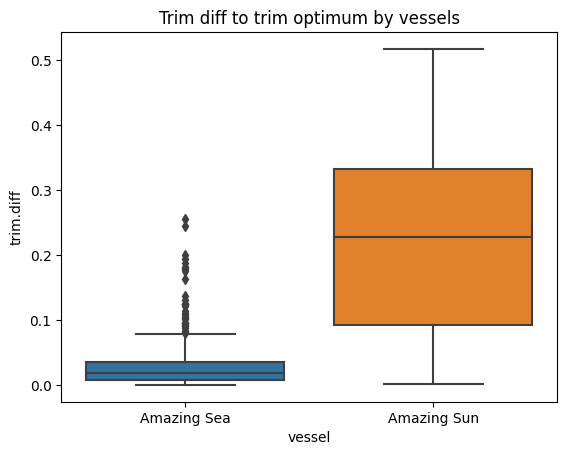

In [44]:
sns.boxplot(data=df, x="vessel", y="trim.diff").set(title='Trim diff to trim optimum by vessels')

## Amazing Sea has smaller variation than Amazing Sun when comparing the difference to optimum trim. More optimal trim might explain smaller power consumption.

In [13]:
df[["vessel", "trim.diff"]].groupby("vessel").mean()

,trim.diff
vessel,
Amazing Sea,0.025152
Amazing Sun,0.223268


In [14]:
# remove rows with NaN coordinates
print(df.shape)
df = df.dropna(subset = ['latitude', 'longitude'])
print(df.shape)

(3530, 11)
(3523, 11)


In [15]:
df.isnull().sum()

time                      0
vessel                    0
departure_port_name     906
arrival_port_name       906
latitude                  0
longitude                 0
stw                       0
trim                      4
trim.optimum           1095
power@propulsion          0
trim.diff              1095
dtype: int64

# Visualisation of the vessel routes

In [16]:
# create map
folium_map = folium.Map()

# auto zoom into area where our vessel coordinates are located
south_west_latitude = min(df.latitude)
south_west_longitude = min(df.longitude)
south_west_corner = [south_west_latitude, south_west_longitude]
print(south_west_corner)

north_east_latitude = max(df.latitude)
north_east_longitude = max(df.longitude)
north_east_corner = [north_east_latitude, north_east_longitude] 
print(north_east_corner)

folium_map.fit_bounds([south_west_corner, north_east_corner])

[16.22246, -88.18137]
[26.09647, -72.25023]


In [17]:
def select_color(vessel_name, power=11):
    if vessel_name == "Amazing Sea":
        if(power < 10):
            return "aqua"
        if(10 <= power <= 17):
            return "blue"
        if (power > 17):
            return "darkblue"
    if vessel_name == "Amazing Sun":
        if(power < 10):
            return "yellow"
        if(10 <= power <= 17):
            return "orange"
        if (power > 17):
            return "firebrick"
    else:
        return "black"

## Vessel routes coordinates on a map

In [18]:
df.sort_values(by=['time'], inplace=True, ignore_index=True)

In [36]:
for index, row in df.iterrows():
    if(row.latitude and row.longitude):
        folium.Circle(radius=10, 
                      location=[row.latitude, row.longitude], 
                      popup=row.arrival_port_name, 
                      color=select_color(row.vessel), 
                      fill=True).add_to(folium_map)
    
folium_map

### Amazing Sea has missing coordinates, which can be clearly seen in the map above.

In [32]:
# create map
folium_map2 = folium.Map()

folium_map2.fit_bounds([south_west_corner, north_east_corner])

## Power consumption of the vessels on a map

In [35]:
for index, row in df.iterrows():
    if(row.latitude and row.longitude):
        if(index < df.shape[0]-1):
            folium.PolyLine([(df.latitude.iloc[index], df.longitude.iloc[index]),(df.latitude.iloc[index+1], df.longitude.iloc[index+1])],
                            color=select_color(row.vessel, row["power@propulsion"]),
                            popup=str(row.time),
                            tooltip=str(df.time.iloc[index+1]),
                            weight=row["power@propulsion"],
                            opacity=0.2).add_to(folium_map2)         
    
folium_map2

[Text(0.5, 1.0, 'Power Propulsion by vessels from Fort Lauderdale to Cozumel')]

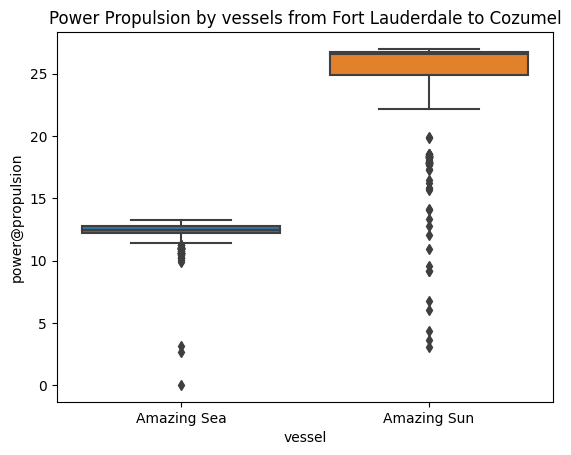

In [45]:
cozumelToLauderdale = df[(df.arrival_port_name=="Cozumel") & (df.departure_port_name=="Fort Lauderdale")]
sns.boxplot(data=cozumelToLauderdale, x="vessel", y="power@propulsion").set(title='Power Propulsion by vessels from Fort Lauderdale to Cozumel')

[Text(0.5, 1.0, 'Speed (Knots) by vessels from Fort Lauderdale to Cozumel')]

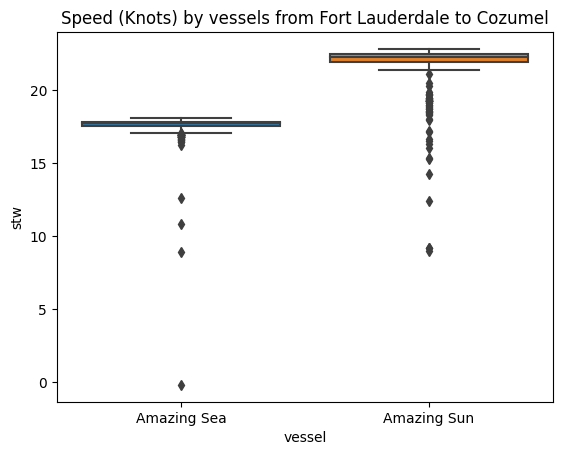

In [46]:
sns.boxplot(data=cozumelToLauderdale, x="vessel", y="stw").set(title='Speed (Knots) by vessels from Fort Lauderdale to Cozumel')

In [39]:
cozumelToLauderdale[df.vessel=="Amazing Sea"].time.max() - cozumelToLauderdale[df.vessel=="Amazing Sea"].time.min()

/var/folders/qy/j35t9wrn08z_rmsffxb5_t8mzt4cq9/T/ipykernel_80907/1387562663.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cozumelToLauderdale[df.vessel=="Amazing Sea"].time.max() - cozumelToLauderdale[df.vessel=="Amazing Sea"].time.min()


Timedelta('1 days 14:15:00')

In [25]:
cozumelToLauderdale[df.vessel=="Amazing Sun"].time.max() - cozumelToLauderdale[df.vessel=="Amazing Sun"].time.min()

/var/folders/qy/j35t9wrn08z_rmsffxb5_t8mzt4cq9/T/ipykernel_80907/3247509644.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cozumelToLauderdale[df.vessel=="Amazing Sun"].time.max() - cozumelToLauderdale[df.vessel=="Amazing Sun"].time.min()


Timedelta('1 days 07:00:00')

In [38]:
df[df.vessel=="Amazing Sea"].time.max() - df[df.vessel=="Amazing Sea"].time.min()

Timedelta('6 days 11:50:00')

In [37]:
df[df.vessel=="Amazing Sun"].time.max() - df[df.vessel=="Amazing Sun"].time.min()

Timedelta('6 days 04:55:00')

### Correlation

In [28]:
trimDiffCorrPower = df["trim.diff"].corr(df["power@propulsion"])
trimDiffCorrPower

0.31169968161596173

In [29]:
corr = df[["stw", "power@propulsion", "trim", "trim.diff"]].corr()
corr.style.background_gradient(cmap='coolwarm').format(precision = 2)

,stw,power@propulsion,trim,trim.diff
stw,1.00,0.92,-0.42,0.15
power@propulsion,0.92,1.00,-0.39,0.31
trim,-0.42,-0.39,1.00,0.83
trim.diff,0.15,0.31,0.83,1.00


# Notes
* Amazing Sea has some missing data points
* Amazing Sea trim is closer to optimal trim than Amazing Sun
* Amazing Sun has 25% higher power propulsion in average than Amazing Sea
* Vessel trim being close to optimal trim correlates (0.31) with smaller power propulsion
    * Note: trim optimum is missing from 906 data rows (=when the vessel is in a port?)